In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
os.environ['CUDA_VISIBLE_DEVICES']='0'

In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torchvision.datasets as datasets
import torchvision.models as models
import torchvision.transforms as transforms
import torchvision.utils as utils

import imagenet_backselect

In [4]:
%config InlineBackend.figure_format='retina'

In [5]:
def accuracy(loader, net, cuda=True):
    correct = 0
    total = 0
    with torch.no_grad():
        for data in loader:
            images, labels = data
            if cuda:
                images = images.cuda()
                labels = labels.cuda()
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100. * correct / total


def find_sis_mask_from_backselect_result(bs_result, sis_threshold):
    mask_after_iter = np.where(
        bs_result.confidences_over_backselect >= sis_threshold)[0][-1]
    #print('Mask after iteration: ', mask_after_iter)
    mask = torch.from_numpy(bs_result.mask_order >= mask_after_iter)
    return mask

# Example SIS from Inception v3

In [13]:
inception = models.inception_v3(pretrained=True)
inception.eval()
inception = inception.cuda()

In [7]:
IMAGENET_DIR = '/path/to/ILSVRC2012/'

normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

val_transform = transforms.Compose([
    # 299 x 299 for Inception-v3
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    normalize,
])

val_data = datasets.ImageNet(IMAGENET_DIR, split='val',
                             transform=val_transform)
print('# val images: ', len(val_data))

val_loader = torch.utils.data.DataLoader(val_data,
                                         batch_size=32,
                                         shuffle=True,
                                         num_workers=4,
                                         pin_memory=True)

# val images:  50000


In [9]:
# Pre-trained Inception v3 val accuracy:
print(accuracy(val_loader, inception))

77.212


In [8]:
images, labels = next(iter(val_loader))

In [9]:
labels

tensor([974,  70,  71, 863, 800, 718, 332, 784, 967, 391, 291, 547, 509, 647,
        326, 669, 181, 495, 706,  73, 981,  82, 195, 878, 621, 532, 769, 711,
        686, 202, 758,  97])

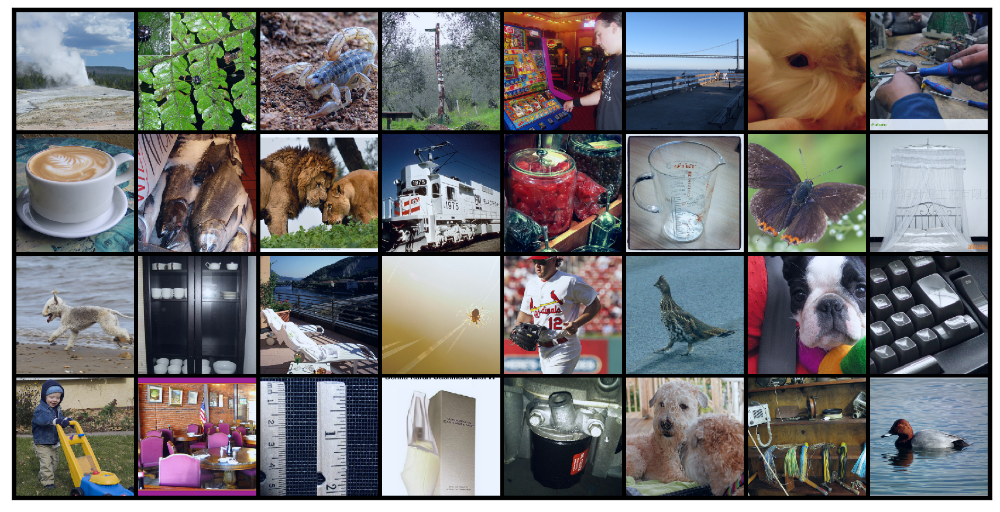

In [10]:
def show(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')
    plt.xticks([])
    plt.yticks([])

plt.figure(figsize=(15, 10))
grid = utils.make_grid(images, nrow=8, padding=10, normalize=True)
show(grid)
plt.show()

In [11]:
%%time

# Run Batched Gradient BackSelect on batch of images.

images, labels = next(iter(val_loader))

batched_gradient_sis_results = imagenet_backselect.run_gradient_backward_selection(
    images,
    inception,
    100,  # Remove k=100 pixels per iteration
    max_iters=None,
    add_random_noise=False,
    cuda=True)

CPU times: user 2min 1s, sys: 47 s, total: 2min 48s
Wall time: 2min 51s


image idx:  0
Original confidence:  0.33713424
Original pred label:  817
Is correct:  True
True Class:  ('sports car', 'sport car')
skipping


image idx:  1
Original confidence:  0.9994837
Original pred label:  594
Is correct:  True
True Class:  ('harp',)


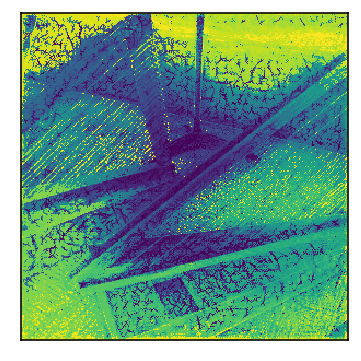

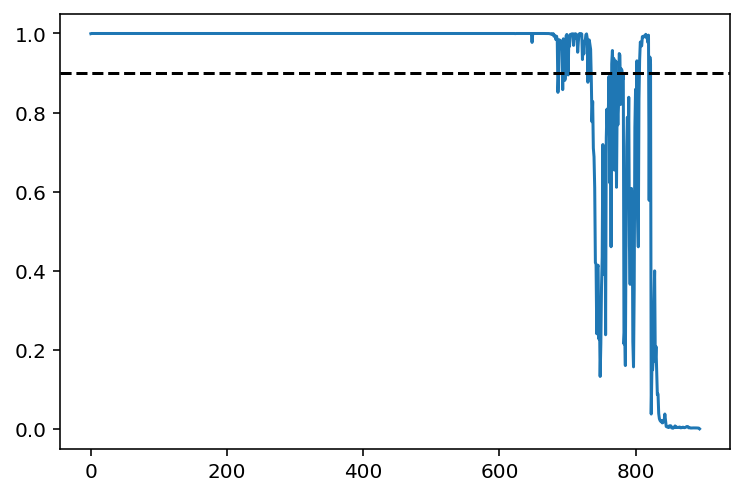

Num pixels masked:  7201 (8.1%)


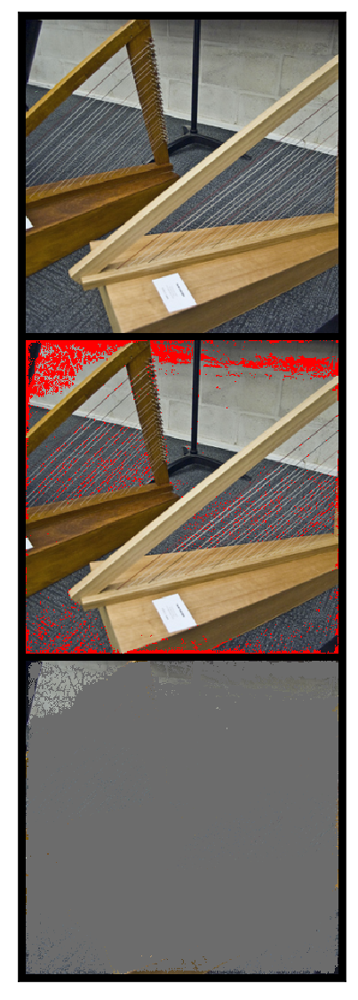

Predicted confidence on masked image:  0.92268914 594



image idx:  2
Original confidence:  0.3152152
Original pred label:  893
Is correct:  False
True Class:  ('pillow',)
skipping


image idx:  3
Original confidence:  0.76608306
Original pred label:  959
Is correct:  False
True Class:  ('meat loaf', 'meatloaf')
skipping


image idx:  4
Original confidence:  0.9213716
Original pred label:  26
Is correct:  True
True Class:  ('common newt', 'Triturus vulgaris')


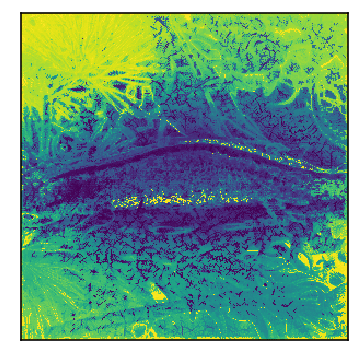

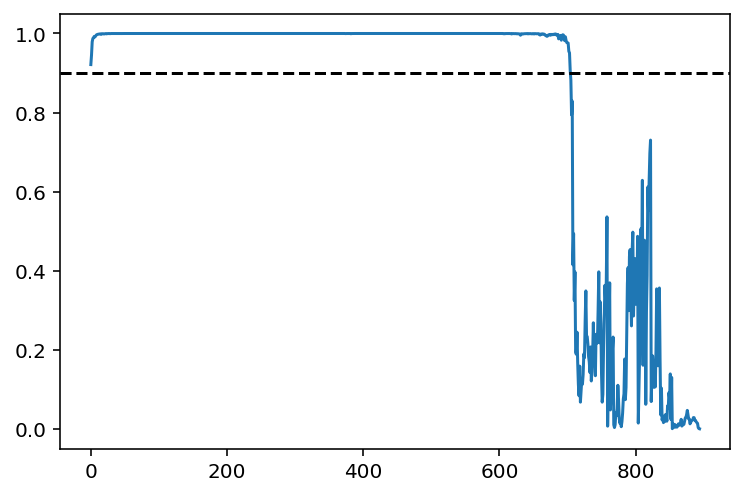

Num pixels masked:  19001 (21.3%)


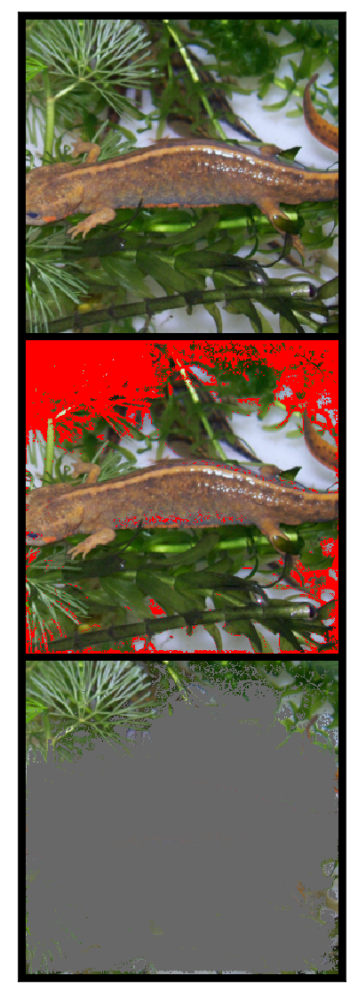

Predicted confidence on masked image:  0.90676224 26



image idx:  5
Original confidence:  0.94327515
Original pred label:  142
Is correct:  True
True Class:  ('dowitcher',)


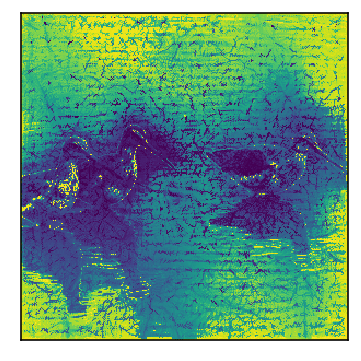

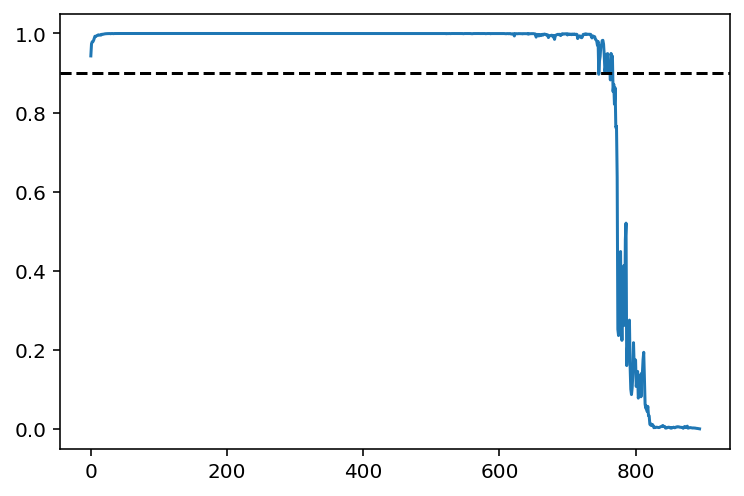

Num pixels masked:  12801 (14.3%)


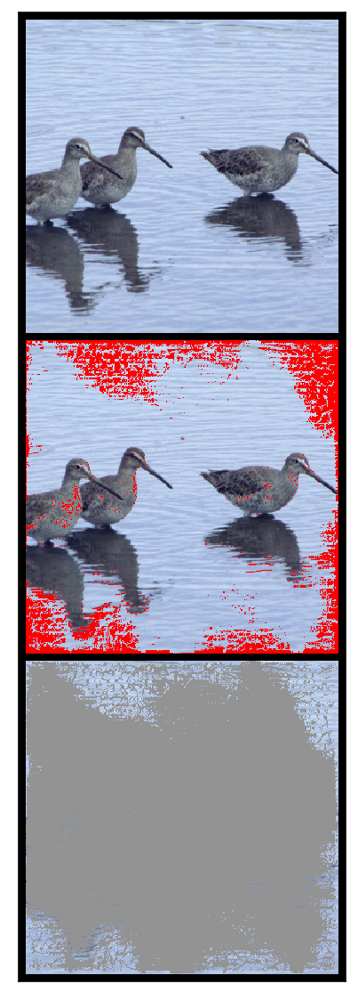

Predicted confidence on masked image:  0.94295377 142



image idx:  6
Original confidence:  0.87968874
Original pred label:  1
Is correct:  True
True Class:  ('goldfish', 'Carassius auratus')
skipping


image idx:  7
Original confidence:  0.9172473
Original pred label:  169
Is correct:  True
True Class:  ('borzoi', 'Russian wolfhound')


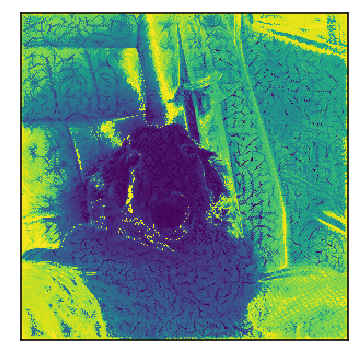

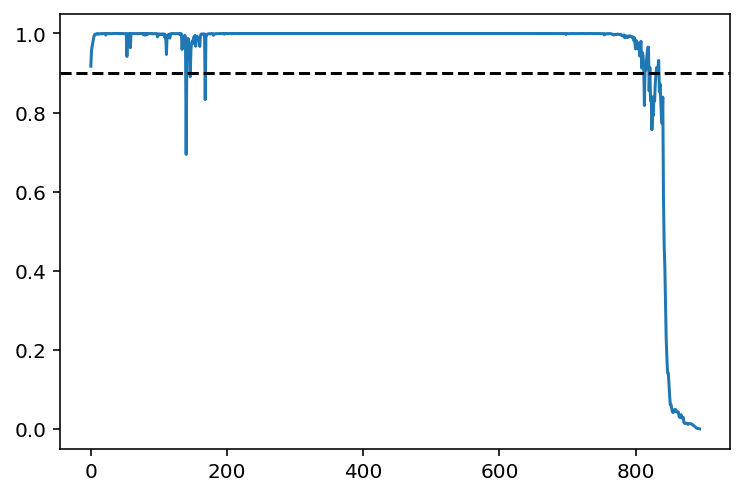

Num pixels masked:  6001 (6.7%)


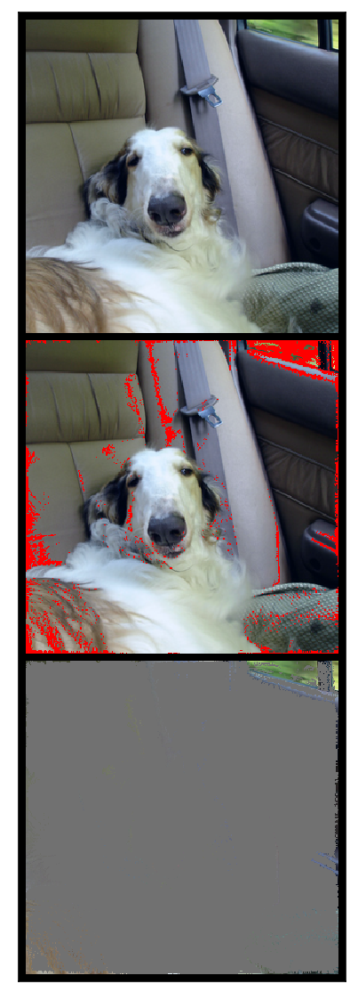

Predicted confidence on masked image:  0.9318884 169



image idx:  8
Original confidence:  0.94575566
Original pred label:  847
Is correct:  False
True Class:  ('amphibian', 'amphibious vehicle')
skipping


image idx:  9
Original confidence:  0.95529056
Original pred label:  716
Is correct:  True
True Class:  ('picket fence', 'paling')


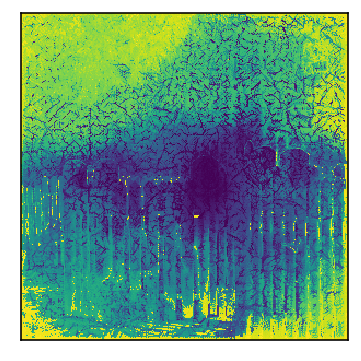

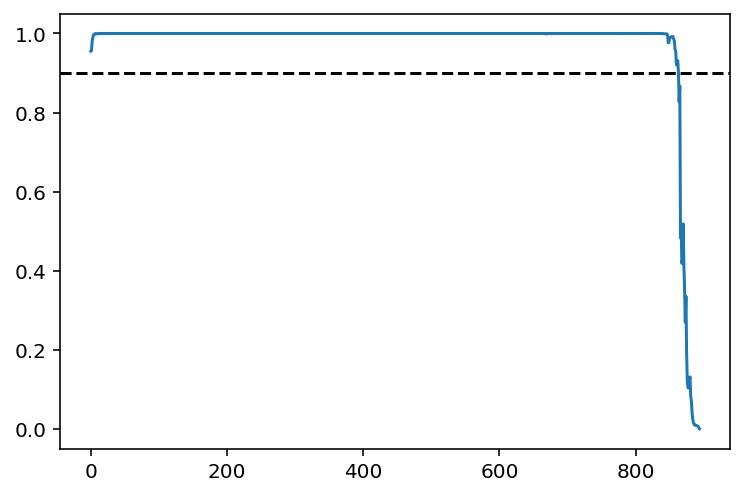

Num pixels masked:  3101 (3.5%)


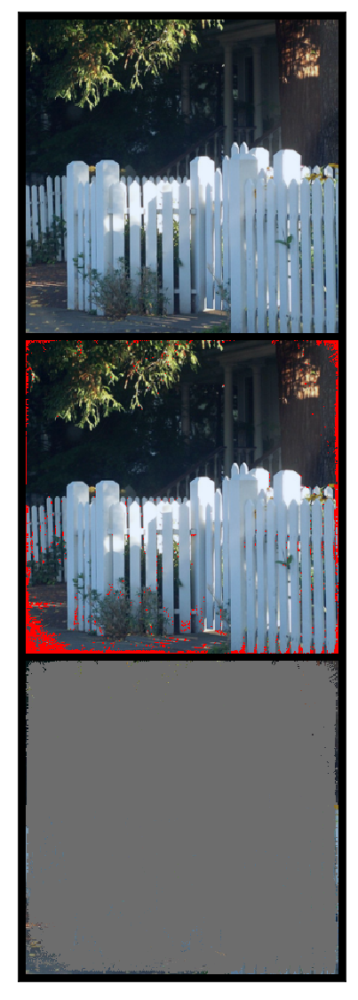

Predicted confidence on masked image:  0.90180683 716



image idx:  10
Original confidence:  0.98827106
Original pred label:  678
Is correct:  True
True Class:  ('neck brace',)


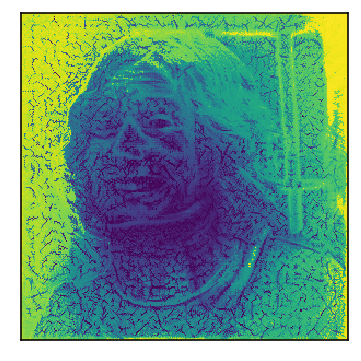

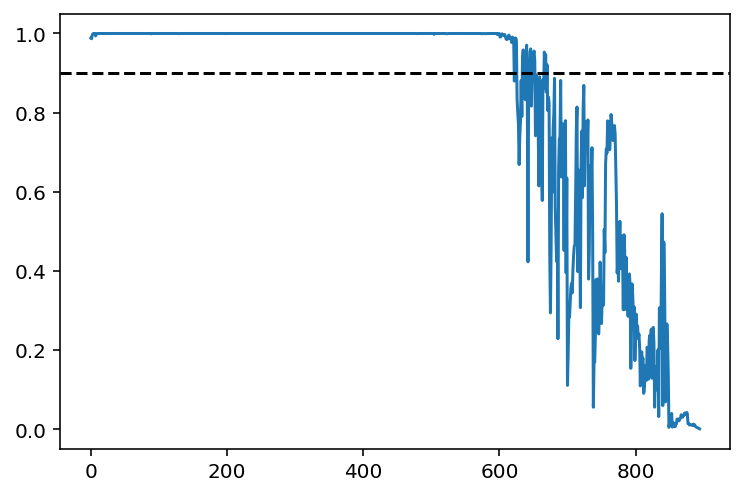

Num pixels masked:  22401 (25.1%)


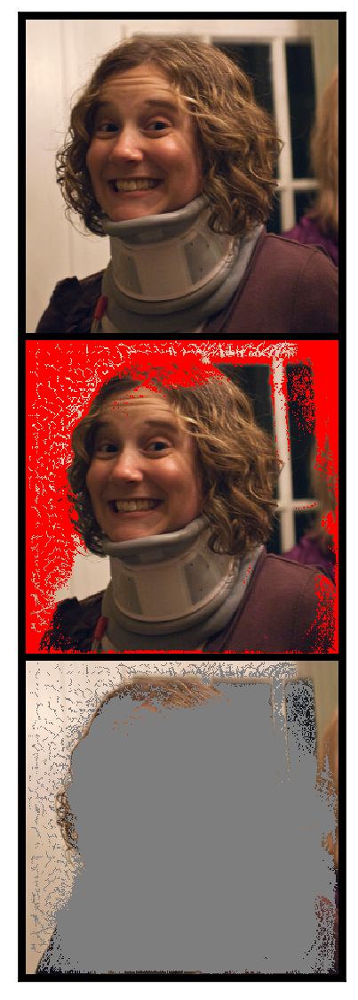

Predicted confidence on masked image:  0.92100346 678



image idx:  11
Original confidence:  0.72753745
Original pred label:  738
Is correct:  True
True Class:  ('pot', 'flowerpot')
skipping


image idx:  12
Original confidence:  0.9345064
Original pred label:  761
Is correct:  True
True Class:  ('remote control', 'remote')


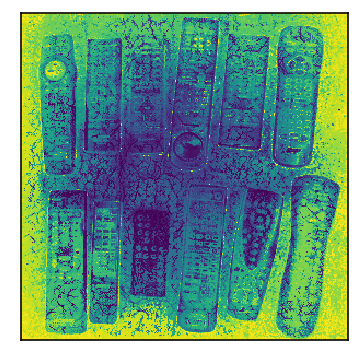

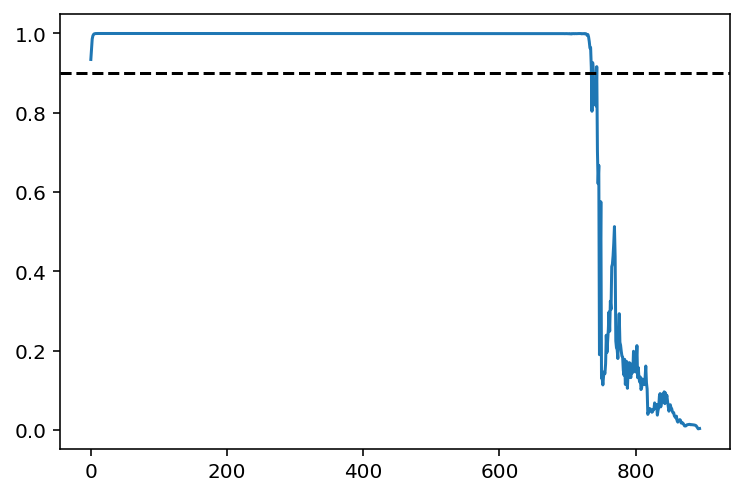

Num pixels masked:  15101 (16.9%)


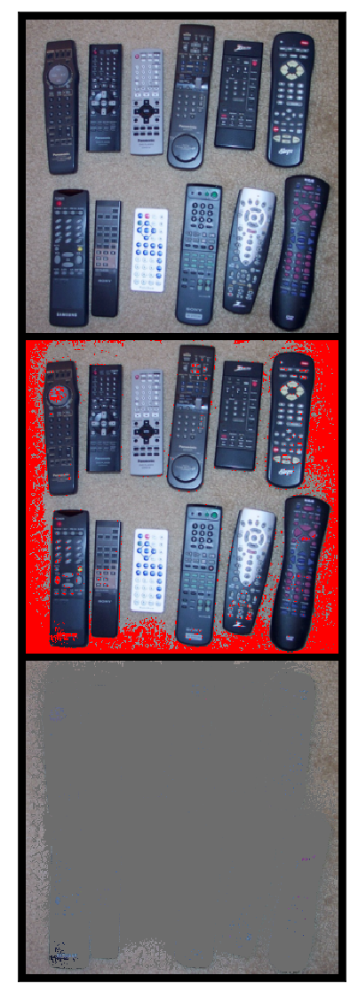

Predicted confidence on masked image:  0.91638047 761



image idx:  13
Original confidence:  0.9550649
Original pred label:  136
Is correct:  True
True Class:  ('European gallinule', 'Porphyrio porphyrio')


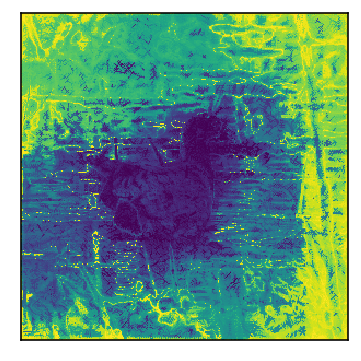

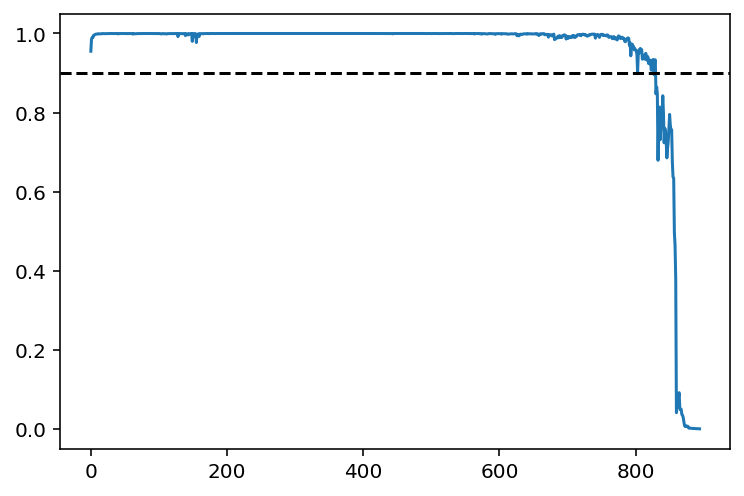

Num pixels masked:  6501 (7.3%)


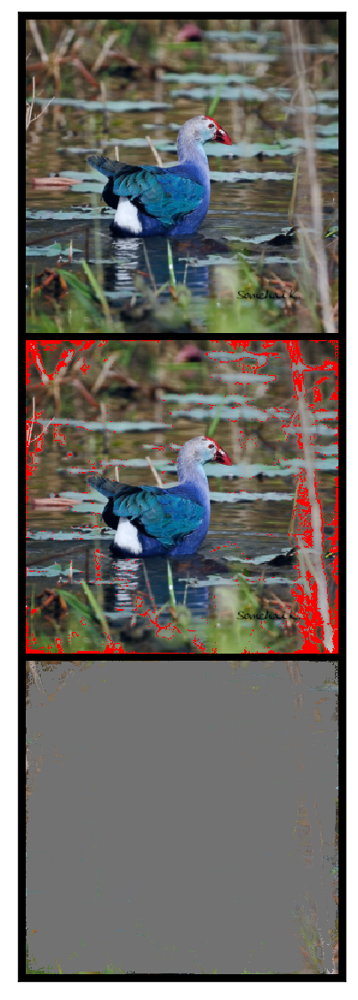

Predicted confidence on masked image:  0.9335115 136



image idx:  14
Original confidence:  0.97816604
Original pred label:  397
Is correct:  True
True Class:  ('puffer', 'pufferfish', 'blowfish', 'globefish')


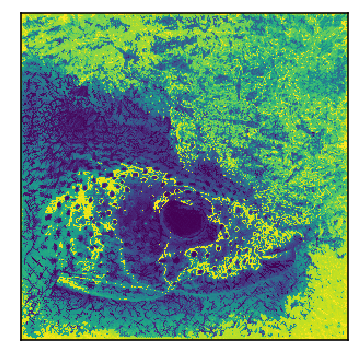

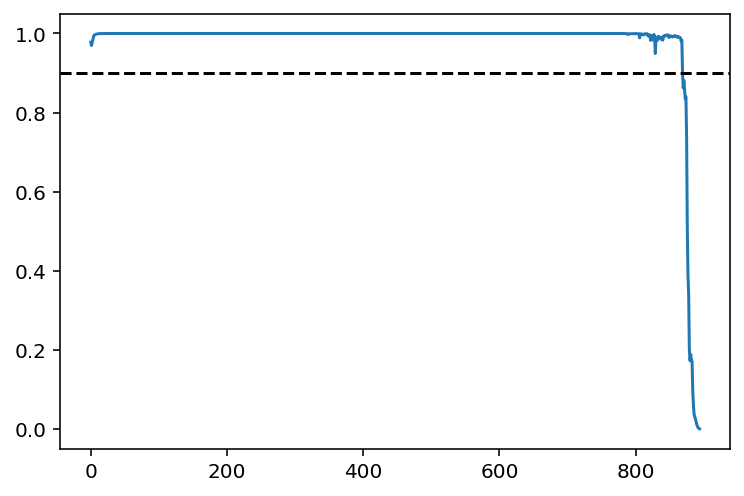

Num pixels masked:  2501 (2.8%)


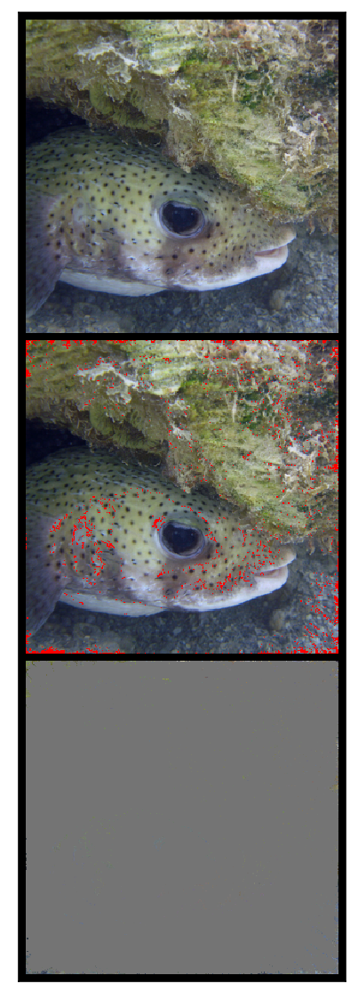

Predicted confidence on masked image:  0.9010313 397



image idx:  15
Original confidence:  0.5995362
Original pred label:  101
Is correct:  True
True Class:  ('tusker',)
skipping


image idx:  16
Original confidence:  0.40227228
Original pred label:  191
Is correct:  True
True Class:  ('Airedale', 'Airedale terrier')
skipping


image idx:  17
Original confidence:  0.9636164
Original pred label:  138
Is correct:  True
True Class:  ('bustard',)


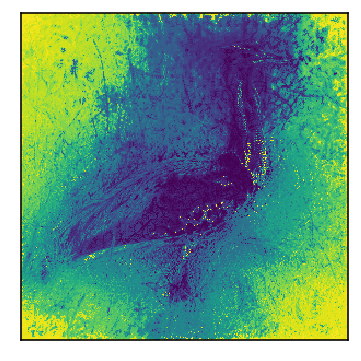

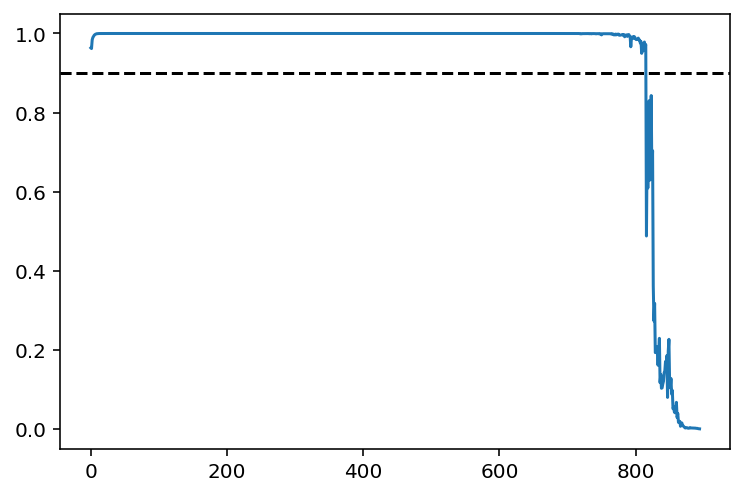

Num pixels masked:  7901 (8.8%)


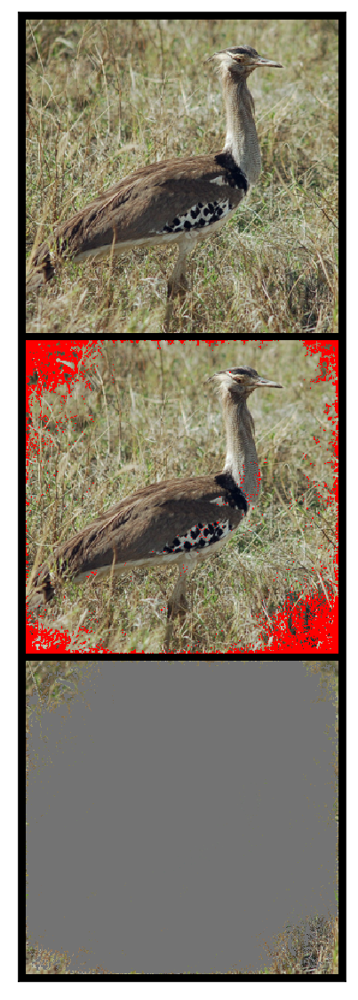

Predicted confidence on masked image:  0.97187275 138



image idx:  18
Original confidence:  0.9857555
Original pred label:  642
Is correct:  True
True Class:  ('marimba', 'xylophone')


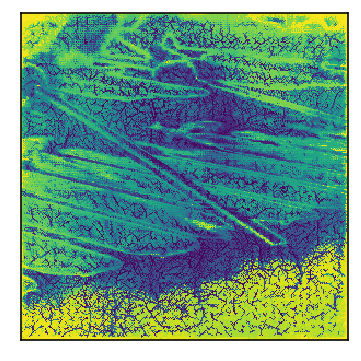

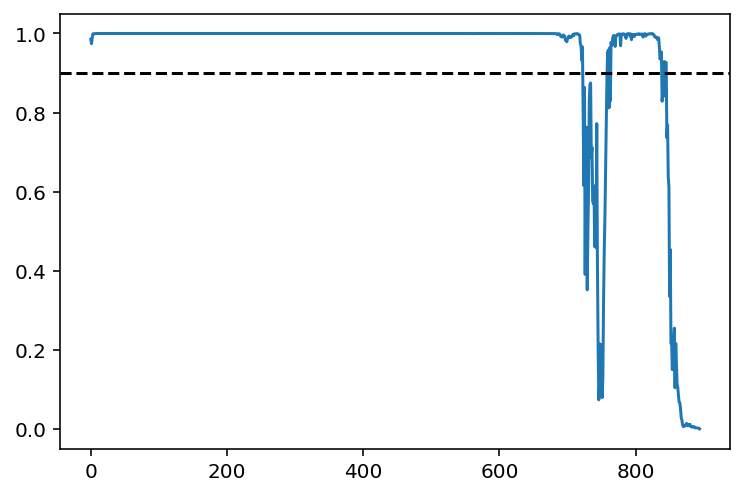

Num pixels masked:  4901 (5.5%)


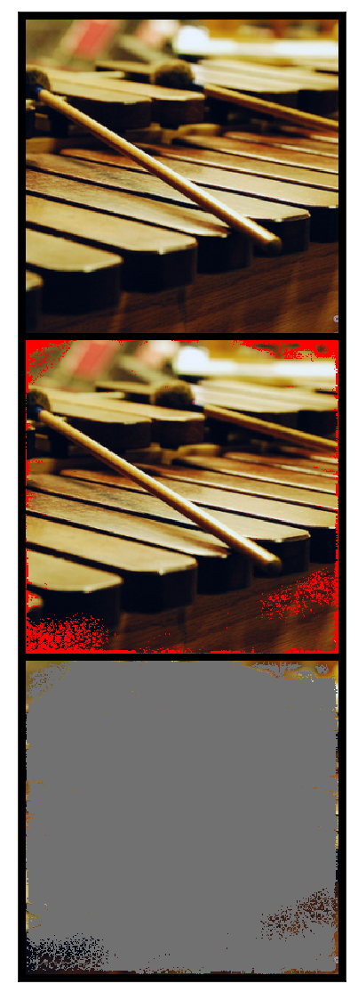

Predicted confidence on masked image:  0.9265693 642



image idx:  19
Original confidence:  0.85938644
Original pred label:  123
Is correct:  True
True Class:  ('spiny lobster', 'langouste', 'rock lobster', 'crawfish', 'crayfish', 'sea crawfish')
skipping


image idx:  20
Original confidence:  0.39909402
Original pred label:  373
Is correct:  True
True Class:  ('macaque',)
skipping


image idx:  21
Original confidence:  0.9941585
Original pred label:  994
Is correct:  True
True Class:  ('stinkhorn', 'carrion fungus')


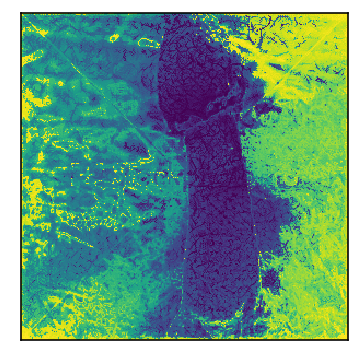

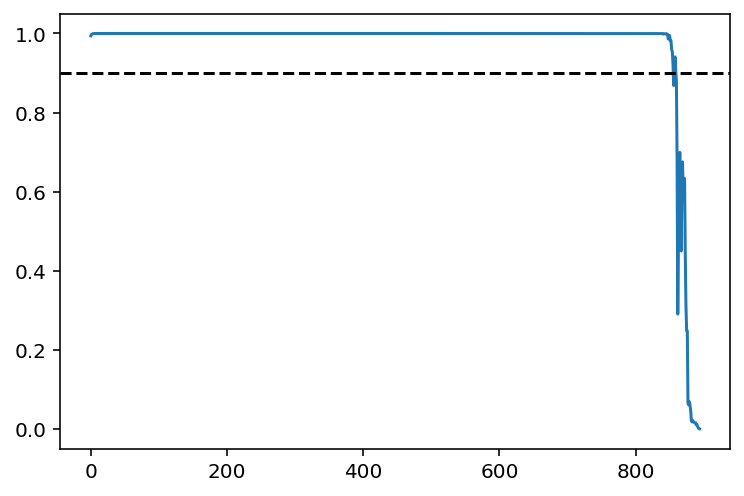

Num pixels masked:  3501 (3.9%)


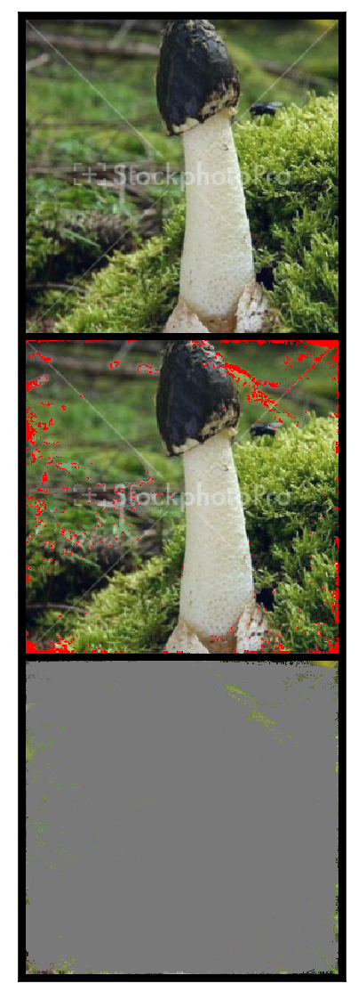

Predicted confidence on masked image:  0.90575606 994



image idx:  22
Original confidence:  0.9412642
Original pred label:  25
Is correct:  True
True Class:  ('European fire salamander', 'Salamandra salamandra')


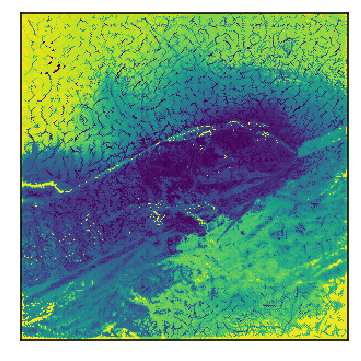

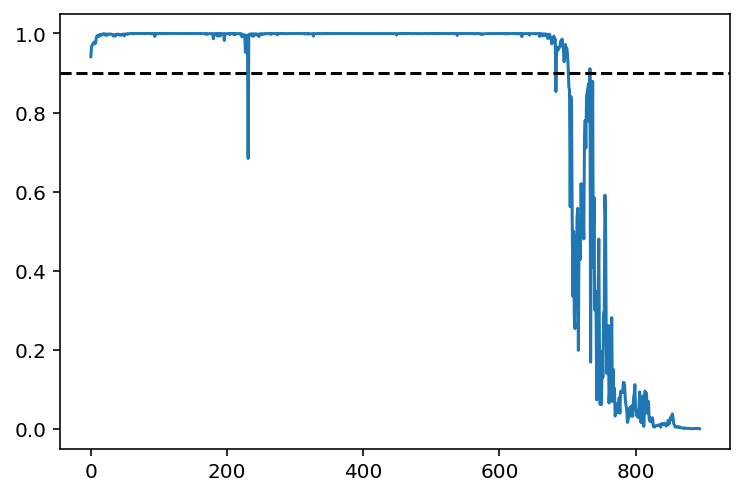

Num pixels masked:  16101 (18.0%)


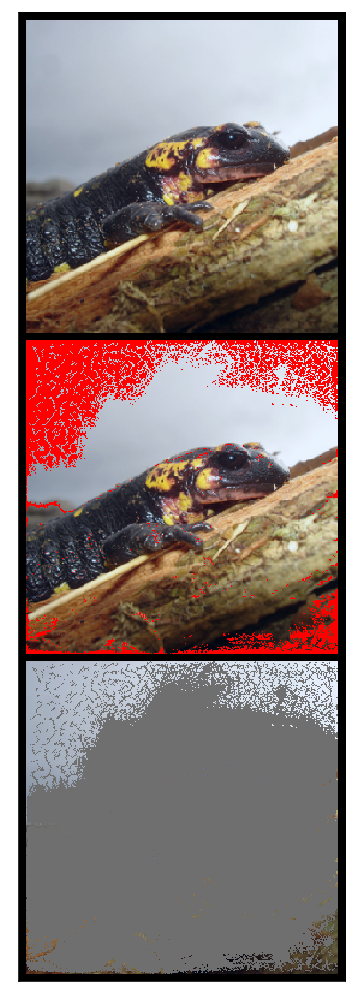

Predicted confidence on masked image:  0.9110617 25



image idx:  23
Original confidence:  0.9379049
Original pred label:  27
Is correct:  True
True Class:  ('eft',)


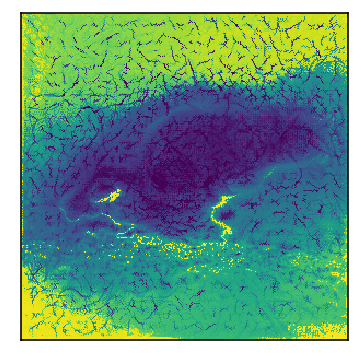

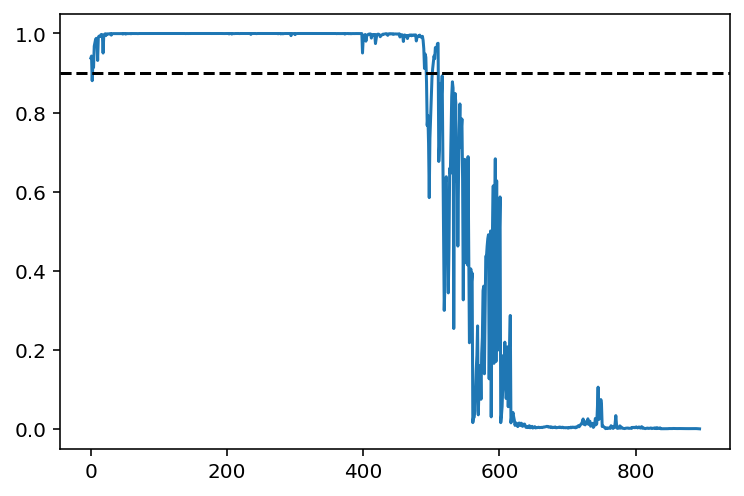

Num pixels masked:  38401 (43.0%)


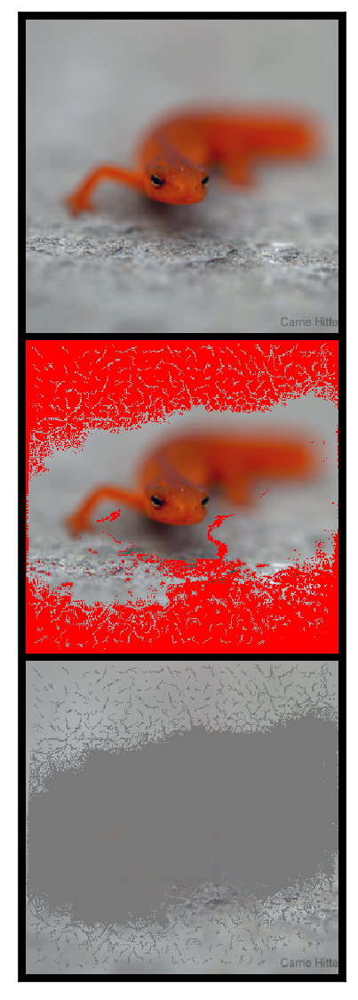

Predicted confidence on masked image:  0.9753236 27



image idx:  24
Original confidence:  0.95404905
Original pred label:  129
Is correct:  True
True Class:  ('spoonbill',)


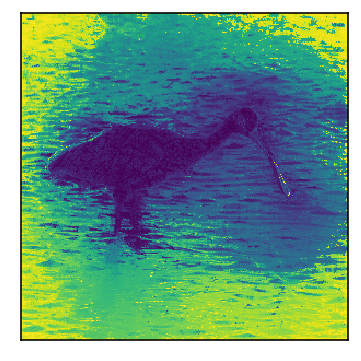

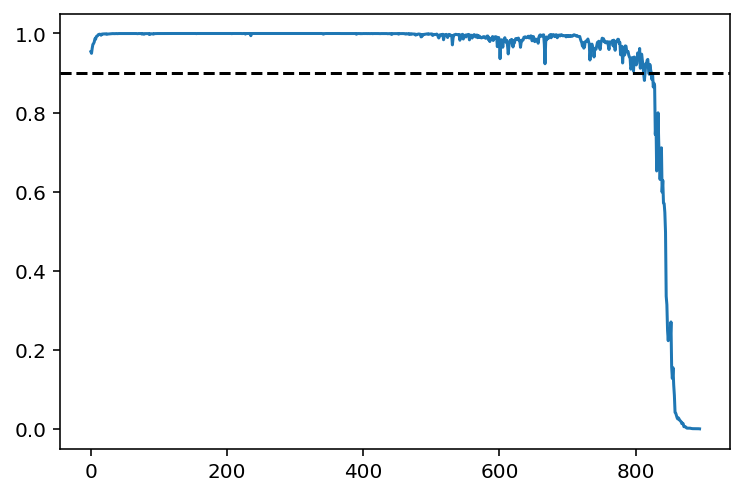

Num pixels masked:  7201 (8.1%)


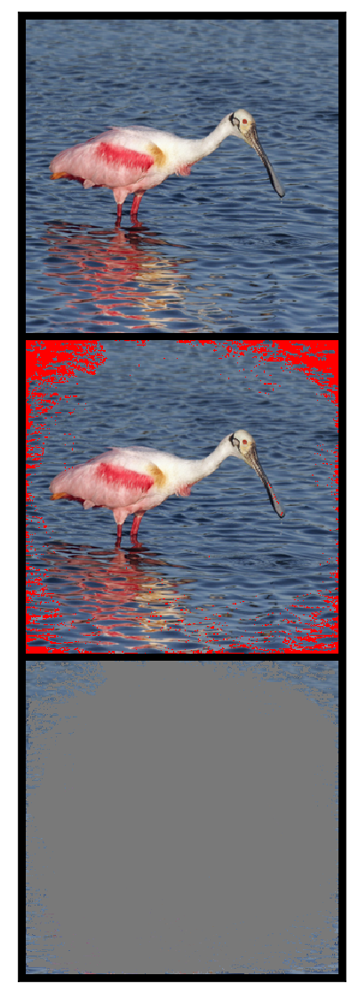

Predicted confidence on masked image:  0.9111089 129



image idx:  25
Original confidence:  0.9998272
Original pred label:  431
Is correct:  True
True Class:  ('bassinet',)


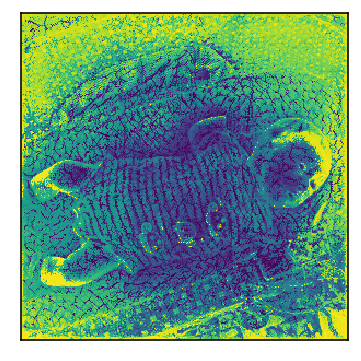

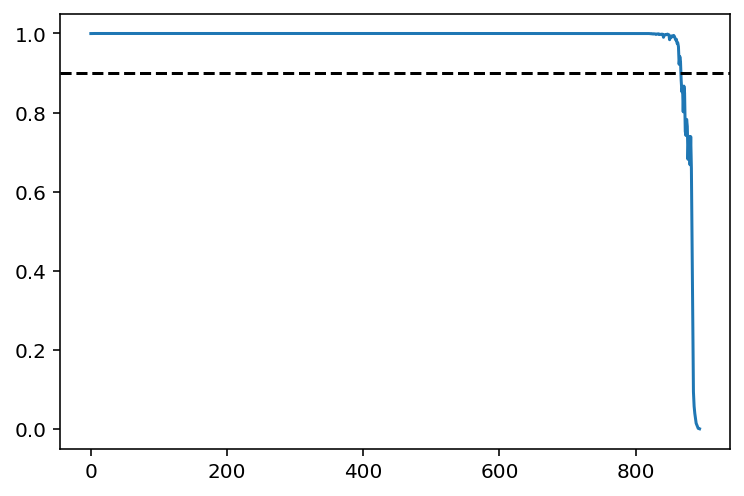

Num pixels masked:  2801 (3.1%)


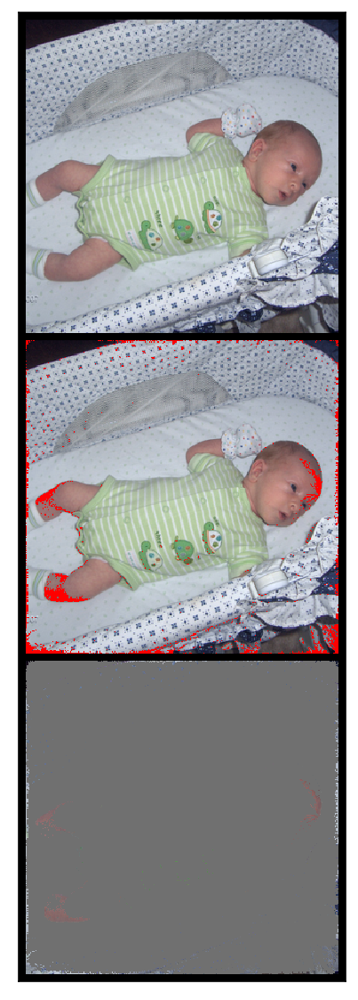

Predicted confidence on masked image:  0.929426 431



image idx:  26
Original confidence:  0.7953388
Original pred label:  101
Is correct:  True
True Class:  ('tusker',)
skipping


image idx:  27
Original confidence:  0.86175525
Original pred label:  435
Is correct:  True
True Class:  ('bathtub', 'bathing tub', 'bath', 'tub')
skipping


image idx:  28
Original confidence:  0.5484554
Original pred label:  496
Is correct:  False
True Class:  ('mitten',)
skipping


image idx:  29
Original confidence:  0.6901464
Original pred label:  280
Is correct:  True
True Class:  ('grey fox', 'gray fox', 'Urocyon cinereoargenteus')
skipping


image idx:  30
Original confidence:  0.9070886
Original pred label:  783
Is correct:  True
True Class:  ('screw',)


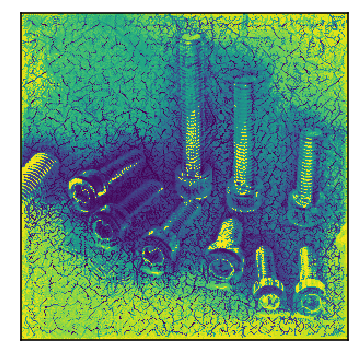

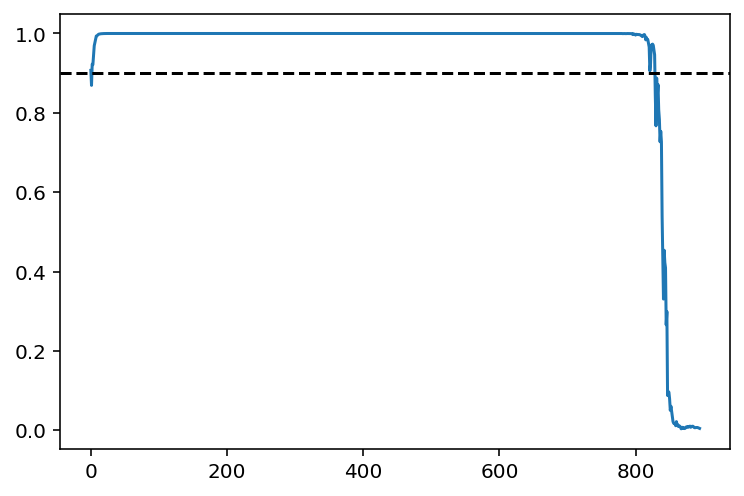

Num pixels masked:  6601 (7.4%)


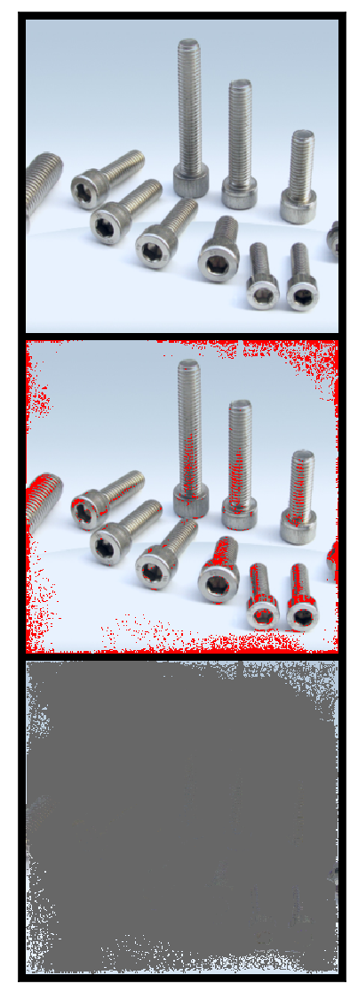

Predicted confidence on masked image:  0.9463241 783



image idx:  31
Original confidence:  0.98472404
Original pred label:  801
Is correct:  True
True Class:  ('snorkel',)


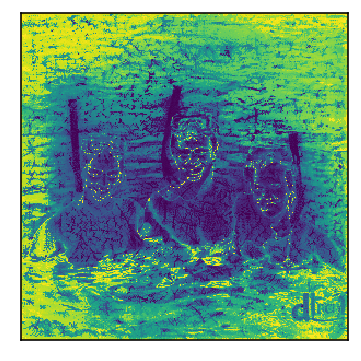

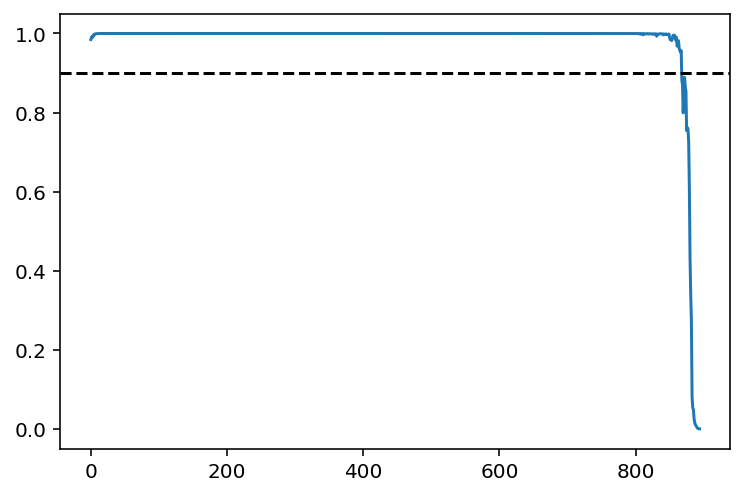

Num pixels masked:  2701 (3.0%)


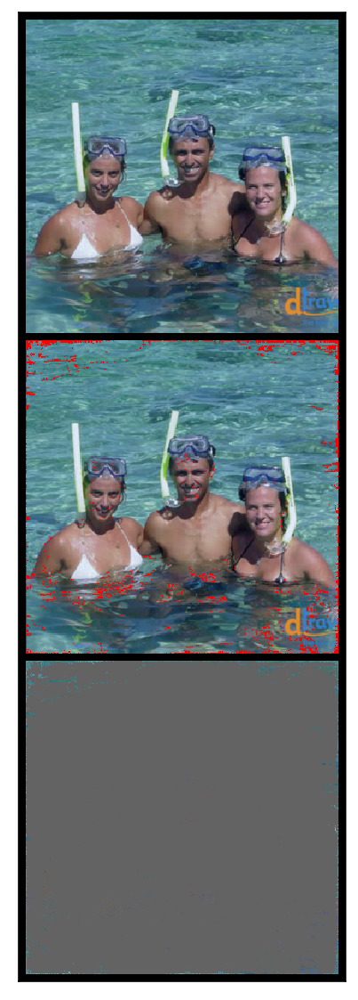

Predicted confidence on masked image:  0.9567632 801





In [12]:
# Generate SIS for val images that are correctly/confidently classified.
# Skip images that are not predicted >= threshold initially.

SIS_THRESHOLD = 0.9

for i in range(len(images)):
    original_image = images[i]
    true_label = labels[i]

    print('image idx: ', i)
    original_pred = inception(original_image.unsqueeze(0).cuda()).detach().cpu()[0]
    original_pred = torch.nn.functional.softmax(original_pred, dim=0).numpy()
    is_correct = bool(original_pred.argmax() == true_label)
    print('Original confidence: ', original_pred.max())
    print('Original pred label: ', original_pred.argmax())
    print('Is correct: ', is_correct)
    print('True Class: ', val_data.classes[true_label])
    if not is_correct or original_pred.max() < 0.9:
        print('skipping\n\n')
        continue

    bs_result = batched_gradient_sis_results[i]

    # Show mask order.
    plt.figure(figsize=(3,3))
    plt.imshow(bs_result.mask_order.sum(axis=0))
    plt.xticks([], [])
    plt.yticks([], [])
    plt.show()

    # Backselect curve.
    plt.plot(np.arange(len(bs_result.confidences_over_backselect)),
             bs_result.confidences_over_backselect[:, original_pred.argmax()])
    plt.axhline(y=0.9, c='black', linestyle='--')
    plt.show()

    # Find SIS mask for confidence >= threshold.
    mask = find_sis_mask_from_backselect_result(bs_result, SIS_THRESHOLD)
    fully_masked_image = torch.zeros(original_image.shape)
    masked_image = torch.where(mask, original_image, fully_masked_image)
    mask_size = int(mask.sum())
    mask_size_frac = mask_size / float(
        original_image.shape[1] * original_image.shape[2])
    print('Num pixels masked:  %s (%.1f%%)' % (mask_size, mask_size_frac * 100.))

    # Print masked image.
    all_red_image = torch.zeros(original_image.shape)
    all_red_image[0, :, :] = original_image.max()
    all_red_image[1, :, :] = original_image.min()
    all_red_image[2, :, :] = original_image.min()

    plt.figure(figsize=(4, 10))
    grid = utils.make_grid(
        torch.stack(
            [original_image,
             torch.where(~mask, original_image, all_red_image),
             masked_image]),
        nrow=1,
        padding=7,
        normalize=True,
    )
    show(grid)
    plt.show()

    # Confidence on masked image.
    preds = inception(masked_image.unsqueeze(0).cuda())
    confidences = torch.nn.functional.softmax(preds, dim=1).detach().cpu().numpy()
    print('Predicted confidence on masked image: ',
          confidences.max(), confidences.argmax())
    print('\n\n')

# Example SIS from ResNet-50

In [8]:
resnet = models.resnet50(pretrained=True)
resnet.eval()
resnet = resnet.cuda()

In [9]:
IMAGENET_DIR = '/path/to/ILSVRC2012/'

normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

val_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    normalize,
])

val_data = datasets.ImageNet(IMAGENET_DIR, split='val',
                             transform=val_transform)
print('# val images: ', len(val_data))

val_loader = torch.utils.data.DataLoader(val_data,
                                         batch_size=32,
                                         shuffle=True,
                                         num_workers=4,
                                         pin_memory=True)

# val images:  50000


In [17]:
# Pre-trained ResNet-50 val accuracy:
print(accuracy(val_loader, resnet))

76.13


In [10]:
images, labels = next(iter(val_loader))

In [11]:
labels

tensor([892, 763, 903, 102,  50, 837, 362, 144, 364, 368, 572, 984,  81, 631,
        857,  34, 249, 298, 241, 896, 557, 204,  79, 652,  37, 912, 180, 719,
        848, 329, 210, 481])

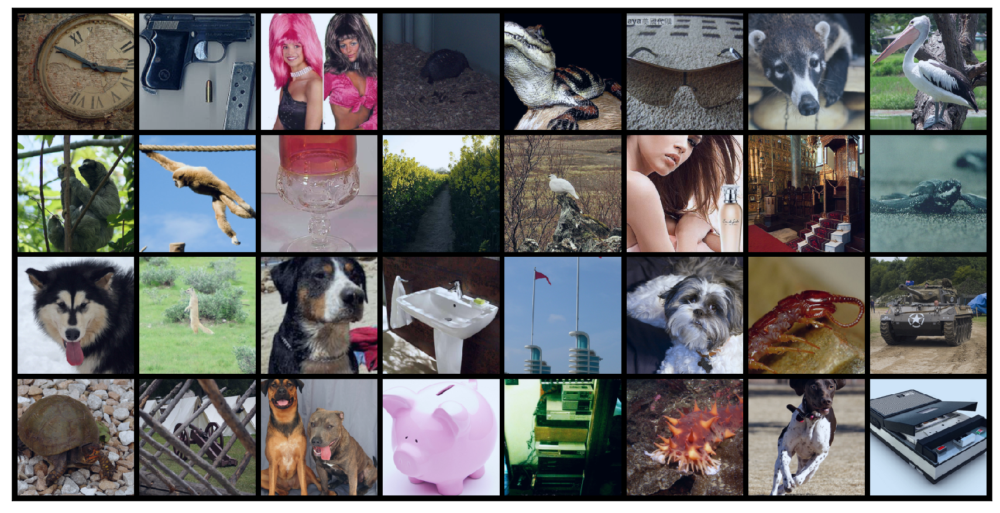

In [12]:
def show(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')
    plt.xticks([])
    plt.yticks([])

plt.figure(figsize=(15, 10))
grid = utils.make_grid(images, nrow=8, padding=10, normalize=True)
show(grid)
plt.show()

In [13]:
%%time

# Run Batched Gradient BackSelect on batch of images.

images, labels = next(iter(val_loader))

batched_gradient_sis_results = imagenet_backselect.run_gradient_backward_selection(
    images,
    resnet,
    100,  # Remove k=100 pixels per iteration
    max_iters=None,
    add_random_noise=False,
    cuda=True)

CPU times: user 42.3 s, sys: 23.6 s, total: 1min 5s
Wall time: 1min 12s


image idx:  0
Original confidence:  0.9998029
Original pred label:  303
Is correct:  True
True Class:  ('long-horned beetle', 'longicorn', 'longicorn beetle')


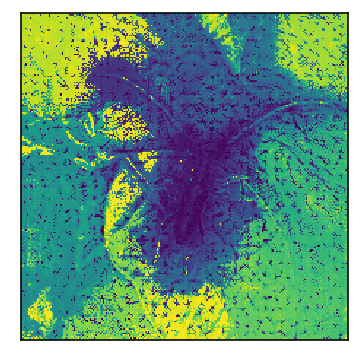

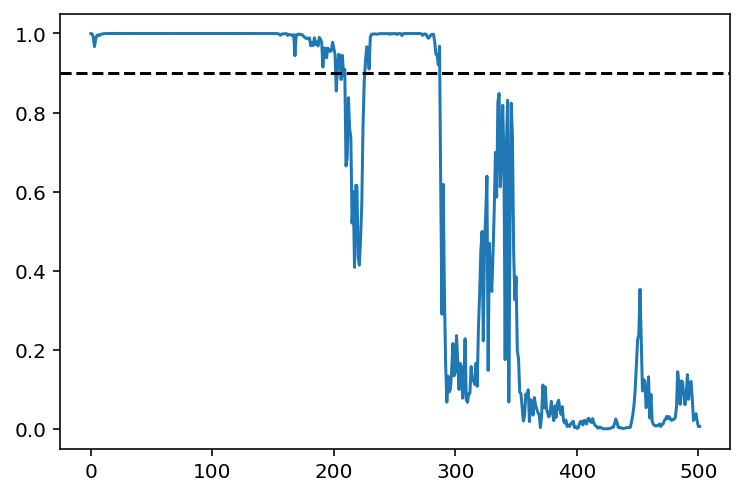

Num pixels masked:  21476 (42.8%)


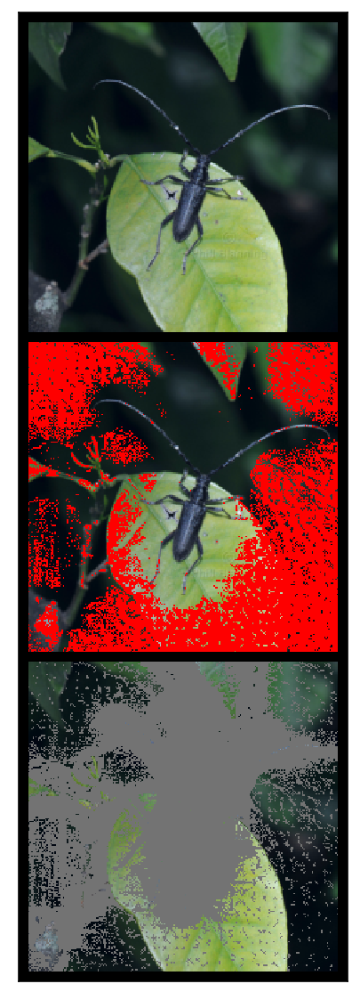

Predicted confidence on masked image:  0.9677789 303



image idx:  1
Original confidence:  0.80283064
Original pred label:  801
Is correct:  True
True Class:  ('snorkel',)
skipping


image idx:  2
Original confidence:  0.2649458
Original pred label:  186
Is correct:  False
True Class:  ('cairn', 'cairn terrier')
skipping


image idx:  3
Original confidence:  0.9955173
Original pred label:  701
Is correct:  True
True Class:  ('parachute', 'chute')


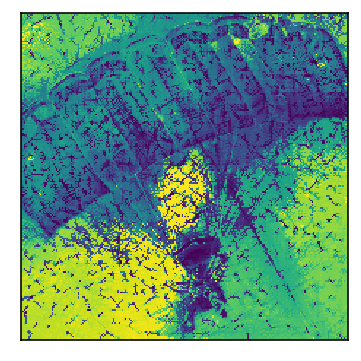

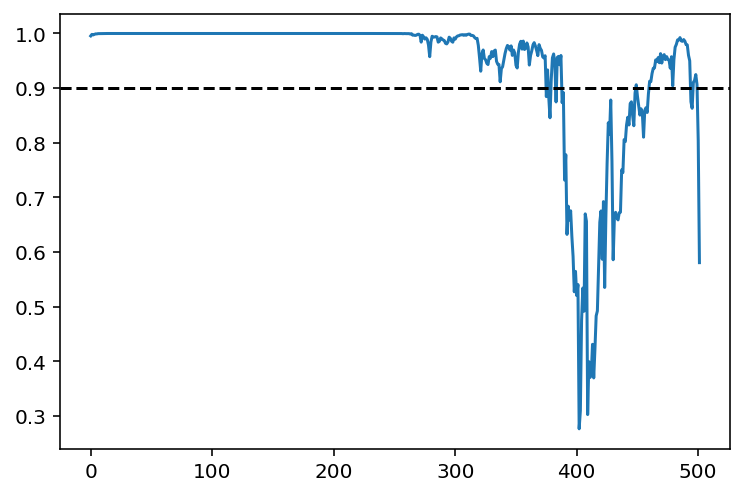

Num pixels masked:  276 (0.6%)


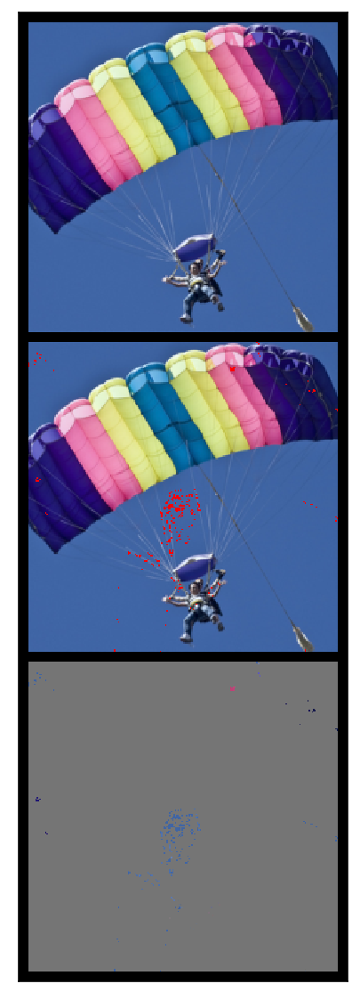

Predicted confidence on masked image:  0.90653265 701



image idx:  4
Original confidence:  0.33368254
Original pred label:  54
Is correct:  False
True Class:  ('frilled lizard', 'Chlamydosaurus kingi')
skipping


image idx:  5
Original confidence:  0.30355105
Original pred label:  585
Is correct:  False
True Class:  ('water bottle',)
skipping


image idx:  6
Original confidence:  0.5064921
Original pred label:  59
Is correct:  False
True Class:  ('green snake', 'grass snake')
skipping


image idx:  7
Original confidence:  0.6010799
Original pred label:  359
Is correct:  False
True Class:  ('polecat', 'fitch', 'foulmart', 'foumart', 'Mustela putorius')
skipping


image idx:  8
Original confidence:  0.8364053
Original pred label:  449
Is correct:  True
True Class:  ('boathouse',)
skipping


image idx:  9
Original confidence:  0.9982888
Original pred label:  852
Is correct:  True
True Class:  ('tennis ball',)


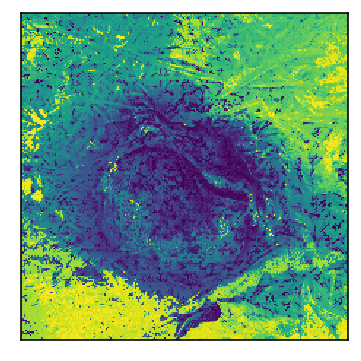

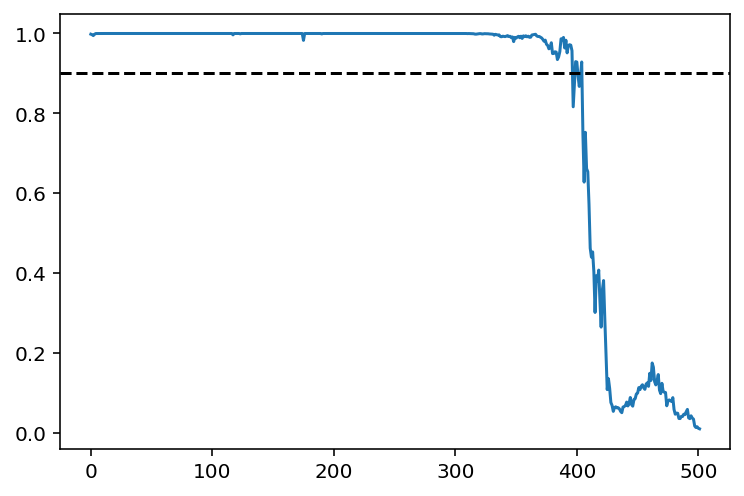

Num pixels masked:  9776 (19.5%)


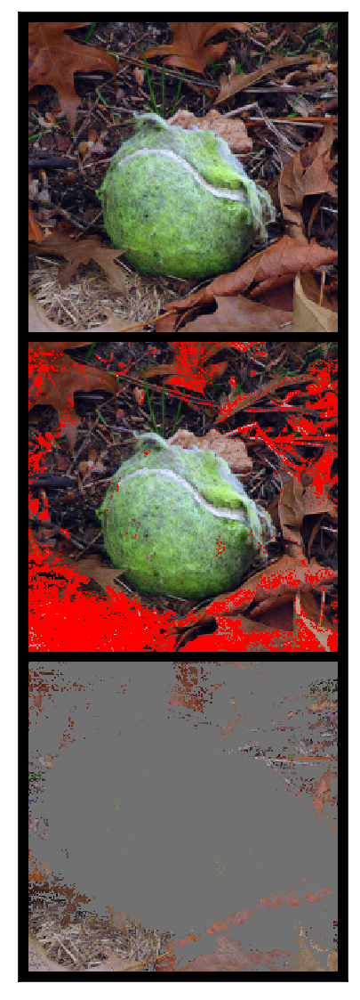

Predicted confidence on masked image:  0.92866594 852



image idx:  10
Original confidence:  0.96797544
Original pred label:  228
Is correct:  True
True Class:  ('komondor',)


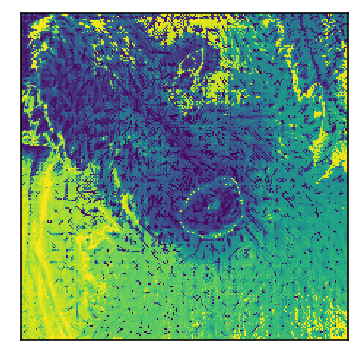

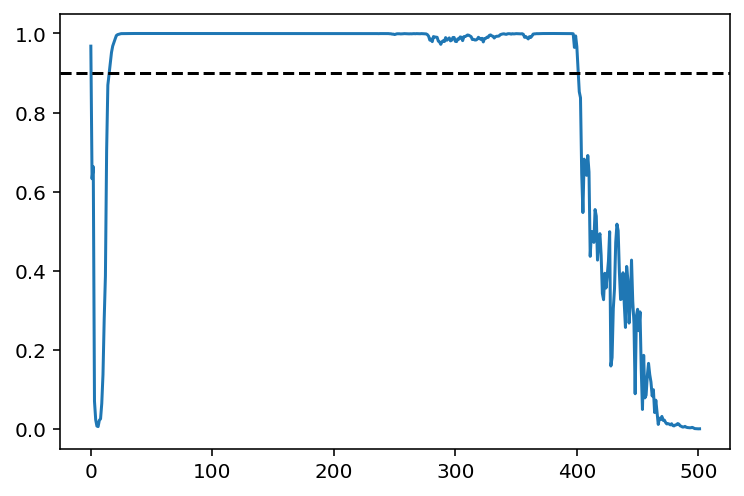

Num pixels masked:  10076 (20.1%)


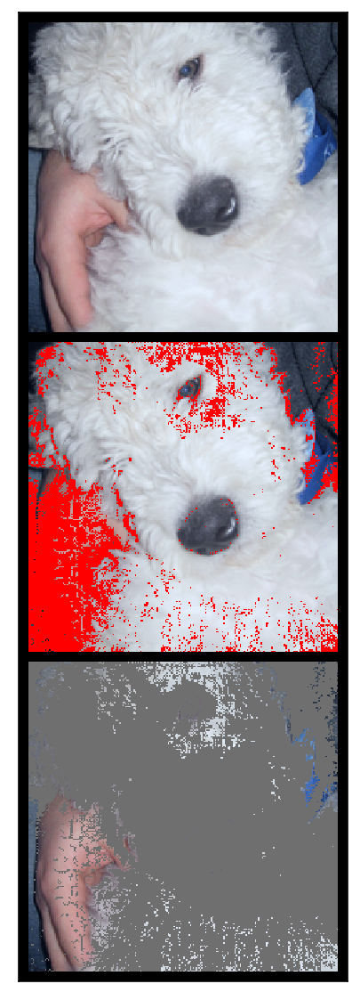

Predicted confidence on masked image:  0.908383 228



image idx:  11
Original confidence:  0.9999969
Original pred label:  736
Is correct:  True
True Class:  ('pool table', 'billiard table', 'snooker table')


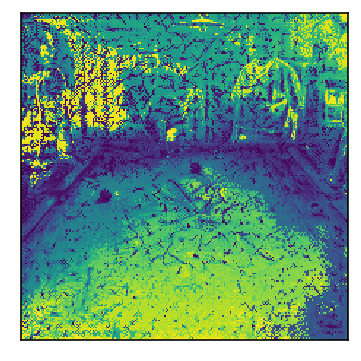

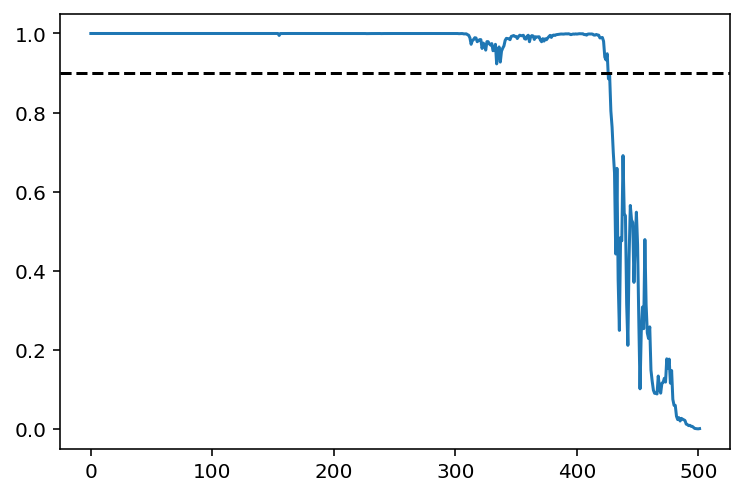

Num pixels masked:  7676 (15.3%)


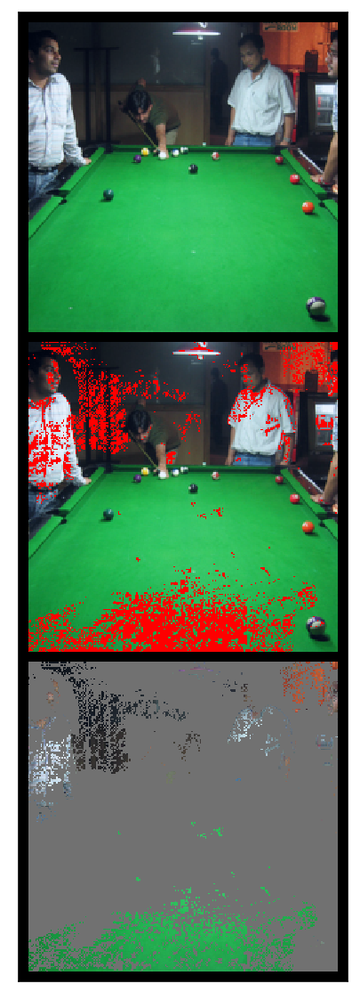

Predicted confidence on masked image:  0.9488339 736



image idx:  12
Original confidence:  0.99811447
Original pred label:  109
Is correct:  True
True Class:  ('brain coral',)


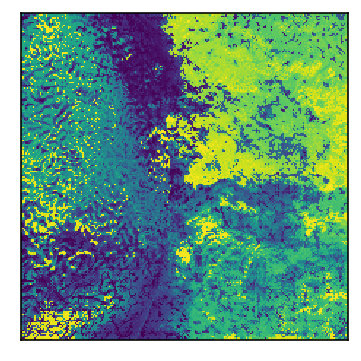

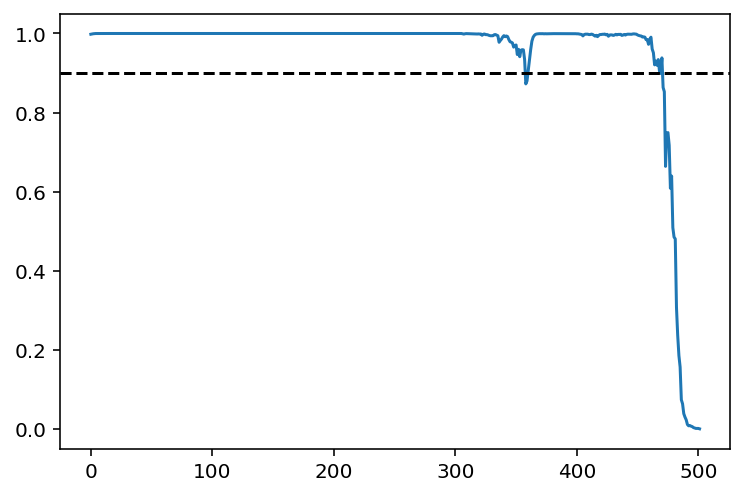

Num pixels masked:  3176 (6.3%)


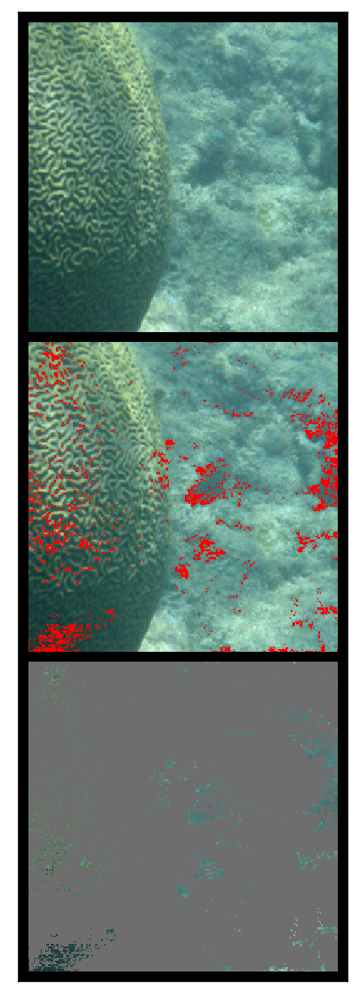

Predicted confidence on masked image:  0.9383814 109



image idx:  13
Original confidence:  0.8662739
Original pred label:  436
Is correct:  True
True Class:  ('beach wagon', 'station wagon', 'wagon', 'estate car', 'beach waggon', 'station waggon', 'waggon')
skipping


image idx:  14
Original confidence:  0.46056926
Original pred label:  943
Is correct:  False
True Class:  ('zucchini', 'courgette')
skipping


image idx:  15
Original confidence:  0.59386456
Original pred label:  453
Is correct:  False
True Class:  ('cassette',)
skipping


image idx:  16
Original confidence:  0.8307508
Original pred label:  245
Is correct:  True
True Class:  ('French bulldog',)
skipping


image idx:  17
Original confidence:  0.9964645
Original pred label:  855
Is correct:  False
True Class:  ('vase',)
skipping


image idx:  18
Original confidence:  0.5663007
Original pred label:  914
Is correct:  False
True Class:  ('schooner',)
skipping


image idx:  19
Original confidence:  0.9785185
Original pred lab

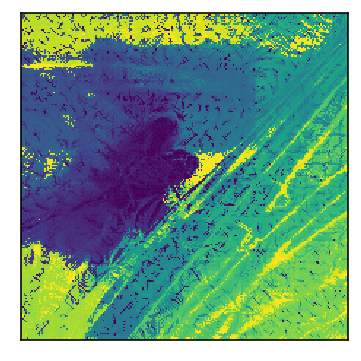

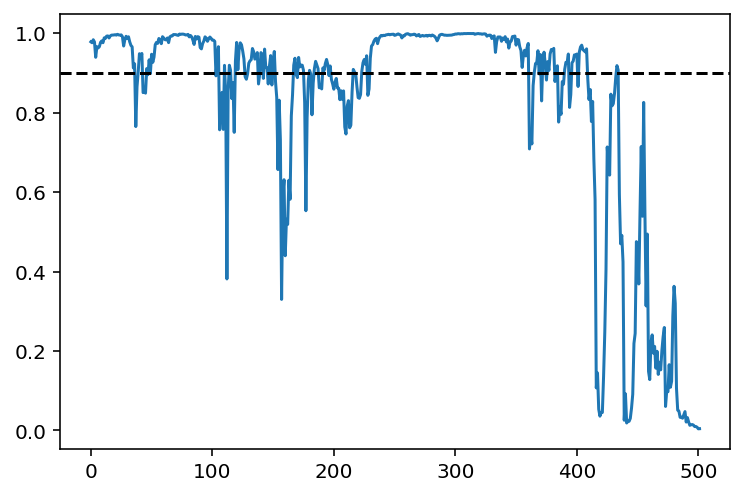

Num pixels masked:  6776 (13.5%)


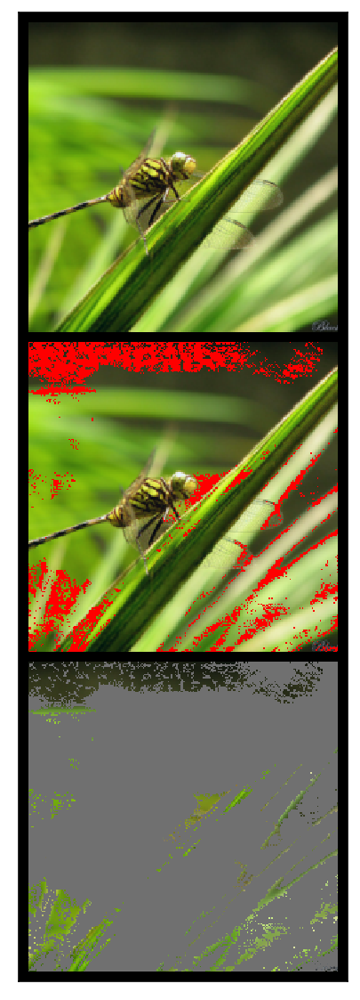

Predicted confidence on masked image:  0.9076428 319



image idx:  20
Original confidence:  0.81031245
Original pred label:  395
Is correct:  True
True Class:  ('gar', 'garfish', 'garpike', 'billfish', 'Lepisosteus osseus')
skipping


image idx:  21
Original confidence:  0.9646013
Original pred label:  648
Is correct:  False
True Class:  ('soap dispenser',)
skipping


image idx:  22
Original confidence:  0.9592009
Original pred label:  669
Is correct:  True
True Class:  ('mosquito net',)


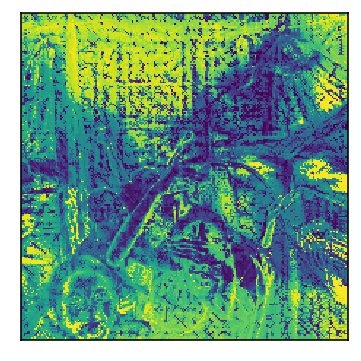

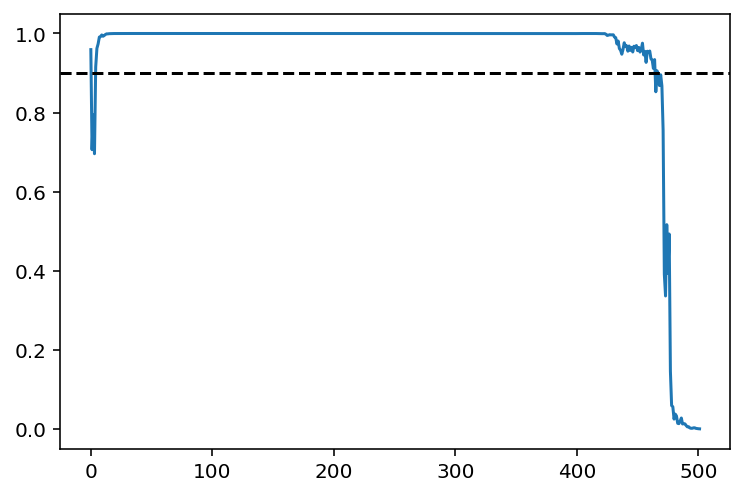

Num pixels masked:  3576 (7.1%)


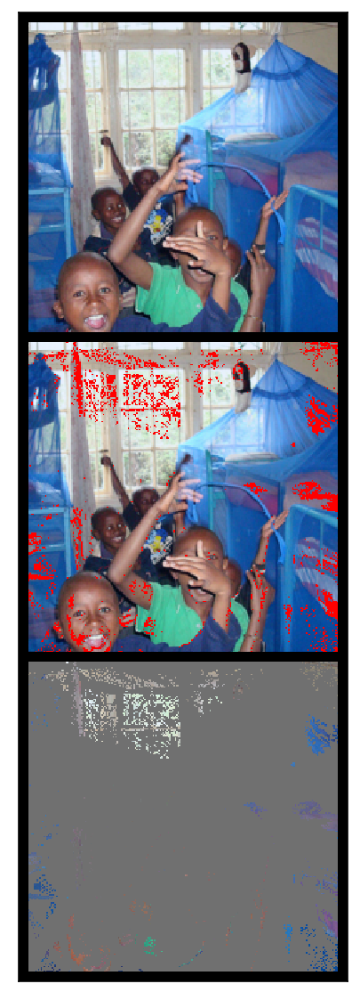

Predicted confidence on masked image:  0.9057265 669



image idx:  23
Original confidence:  0.36335468
Original pred label:  543
Is correct:  False
True Class:  ('barbell',)
skipping


image idx:  24
Original confidence:  0.8563217
Original pred label:  973
Is correct:  True
True Class:  ('coral reef',)
skipping


image idx:  25
Original confidence:  0.36693648
Original pred label:  639
Is correct:  False
True Class:  ('maillot',)
skipping


image idx:  26
Original confidence:  0.903631
Original pred label:  930
Is correct:  True
True Class:  ('French loaf',)


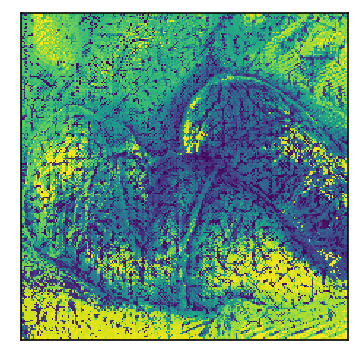

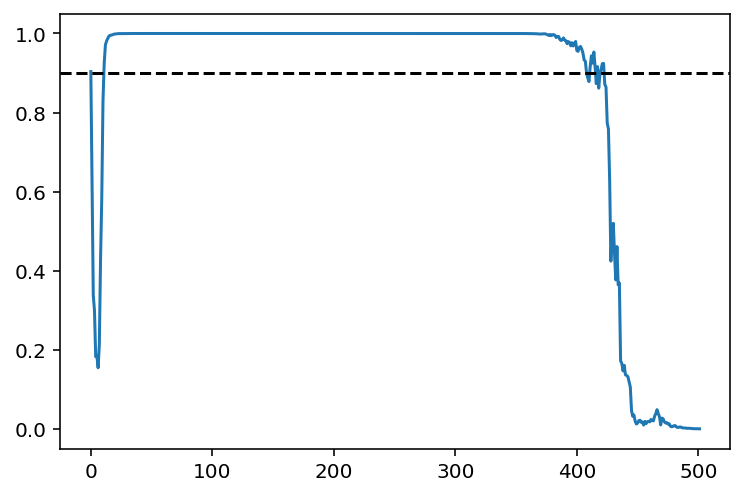

Num pixels masked:  7976 (15.9%)


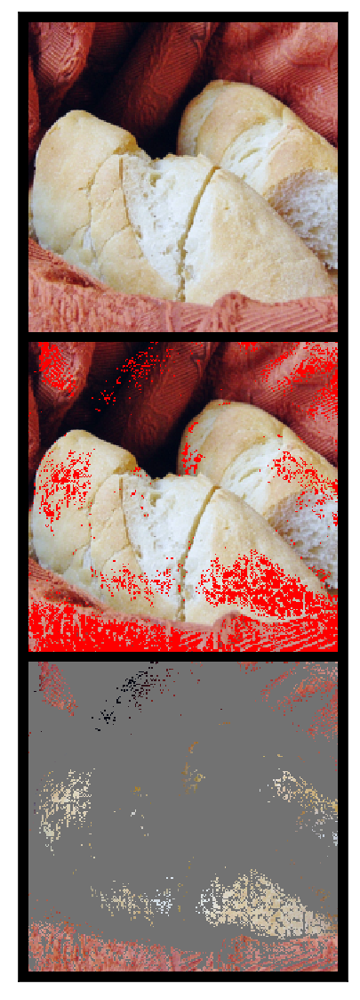

Predicted confidence on masked image:  0.9242284 930



image idx:  27
Original confidence:  0.99999774
Original pred label:  105
Is correct:  True
True Class:  ('koala', 'koala bear', 'kangaroo bear', 'native bear', 'Phascolarctos cinereus')


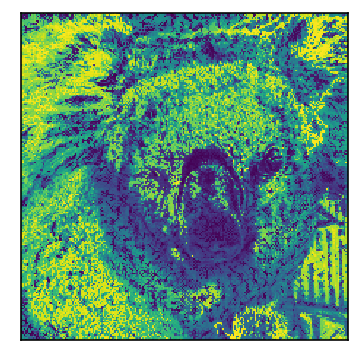

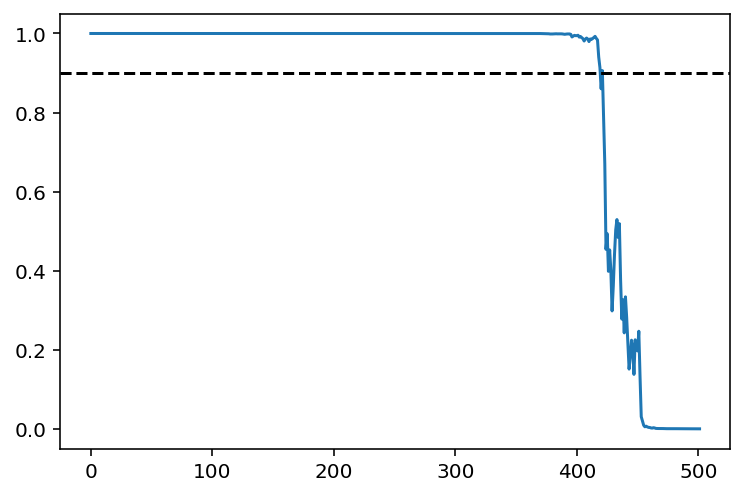

Num pixels masked:  8076 (16.1%)


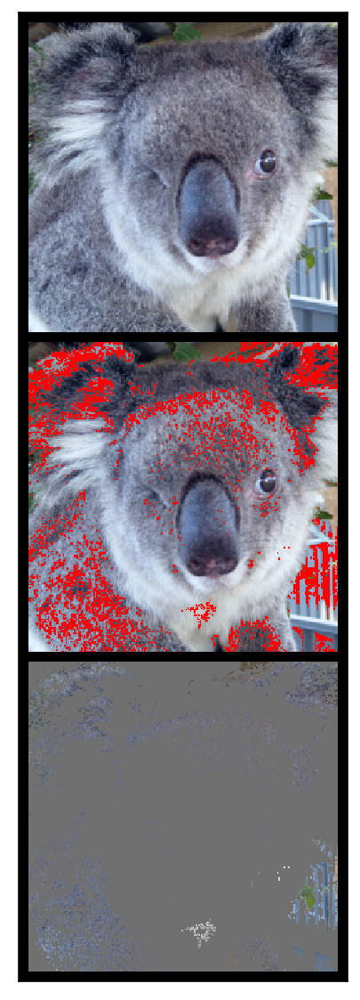

Predicted confidence on masked image:  0.90620035 105



image idx:  28
Original confidence:  0.990781
Original pred label:  966
Is correct:  True
True Class:  ('red wine',)


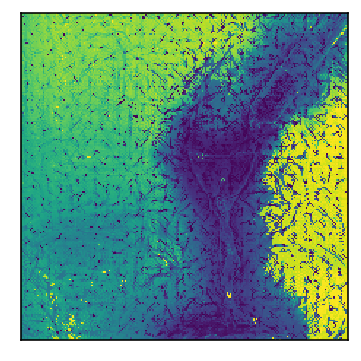

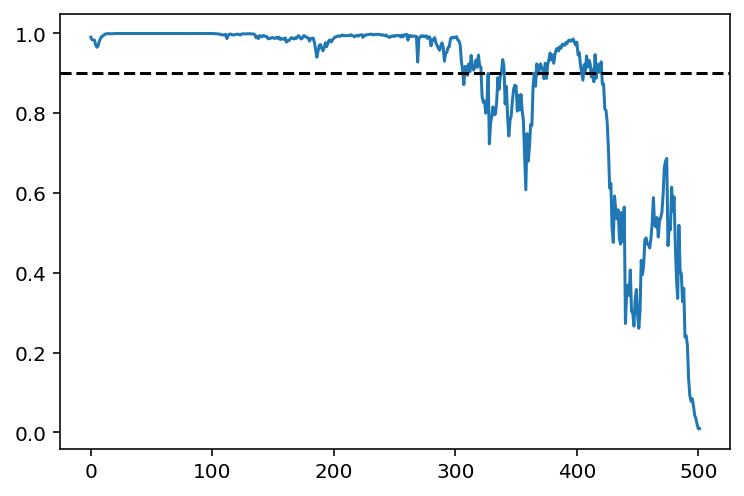

Num pixels masked:  8176 (16.3%)


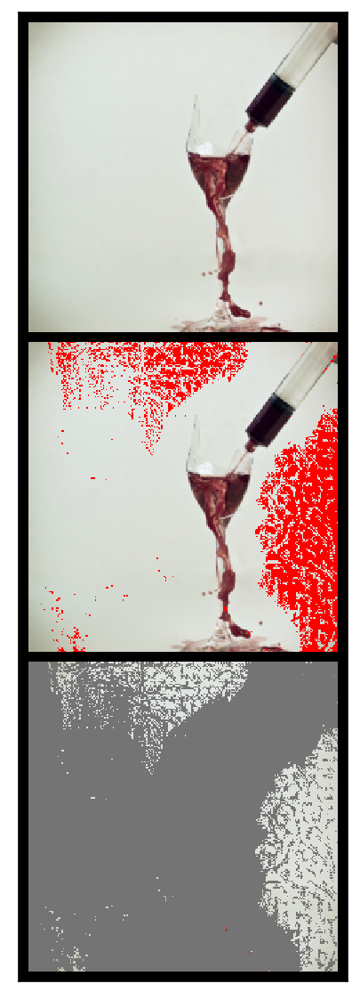

Predicted confidence on masked image:  0.9290689 966



image idx:  29
Original confidence:  0.69659805
Original pred label:  93
Is correct:  True
True Class:  ('hornbill',)
skipping


image idx:  30
Original confidence:  0.32736045
Original pred label:  887
Is correct:  False
True Class:  ('handkerchief', 'hankie', 'hanky', 'hankey')
skipping


image idx:  31
Original confidence:  0.53447926
Original pred label:  497
Is correct:  False
True Class:  ('recreational vehicle', 'RV', 'R.V.')
skipping




In [16]:
# Generate SIS for val images that are correctly/confidently classified.
# Skip images that are not predicted >= threshold initially.

SIS_THRESHOLD = 0.9

for i in range(len(images)):
    original_image = images[i]
    true_label = labels[i]

    print('image idx: ', i)
    original_pred = resnet(original_image.unsqueeze(0).cuda()).detach().cpu()[0]
    original_pred = torch.nn.functional.softmax(original_pred, dim=0).numpy()
    is_correct = bool(original_pred.argmax() == true_label)
    print('Original confidence: ', original_pred.max())
    print('Original pred label: ', original_pred.argmax())
    print('Is correct: ', is_correct)
    print('True Class: ', val_data.classes[true_label])
    if not is_correct or original_pred.max() < 0.9:
        print('skipping\n\n')
        continue

    bs_result = batched_gradient_sis_results[i]

    # Show mask order.
    plt.figure(figsize=(3,3))
    plt.imshow(bs_result.mask_order.sum(axis=0))
    plt.xticks([], [])
    plt.yticks([], [])
    plt.show()

    # Plot backselect curve.
    plt.plot(np.arange(len(bs_result.confidences_over_backselect)),
             bs_result.confidences_over_backselect[:, original_pred.argmax()])
    plt.axhline(y=0.9, c='black', linestyle='--')
    plt.show()

    # Find SIS mask for confidence >= threshold.
    mask = find_sis_mask_from_backselect_result(bs_result, SIS_THRESHOLD)
    fully_masked_image = torch.zeros(original_image.shape)
    masked_image = torch.where(mask, original_image, fully_masked_image)
    mask_size = int(mask.sum())
    mask_size_frac = mask_size / float(
        original_image.shape[1] * original_image.shape[2])
    print('Num pixels masked:  %s (%.1f%%)' % (mask_size, mask_size_frac * 100.))

    # Print masked image.
    all_red_image = torch.zeros(original_image.shape)
    all_red_image[0, :, :] = original_image.max()
    all_red_image[1, :, :] = original_image.min()
    all_red_image[2, :, :] = original_image.min()

    plt.figure(figsize=(4, 10))
    grid = utils.make_grid(
        torch.stack(
            [original_image,
             torch.where(~mask, original_image, all_red_image),
             masked_image]),
        nrow=1,
        padding=7,
        normalize=True,
    )
    show(grid)
    plt.show()

    # Confidence on masked image.
    preds = resnet(masked_image.unsqueeze(0).cuda())
    confidences = torch.nn.functional.softmax(preds, dim=1).detach().cpu().numpy()
    print('Predicted confidence on masked image: ',
          confidences.max(), confidences.argmax())
    print('\n\n')